# Detectron2


# Install dependencies and detectron2

In [53]:
# install dependencies
!pip install -U torch torchvision cython Pillow==6.2.2
!pip install -U 'git+https://github.com/cocodataset/cocoapi.git#subdirectory=PythonAPI'
import torch, torchvision
torch.__version__
!gcc --version
# opencv is pre-installed on colab

Requirement already up-to-date: torch in /usr/local/lib/python3.6/dist-packages (1.4.0)
Requirement already up-to-date: torchvision in /usr/local/lib/python3.6/dist-packages (0.5.0)
Requirement already up-to-date: cython in /usr/local/lib/python3.6/dist-packages (0.29.14)
Requirement already up-to-date: Pillow==6.2.2 in /usr/local/lib/python3.6/dist-packages (6.2.2)
  Cloning https://github.com/cocodataset/cocoapi.git to /tmp/pip-req-build-wdy9_msa
  Running command git clone -q https://github.com/cocodataset/cocoapi.git /tmp/pip-req-build-wdy9_msa
  Created wheel for pycocotools: filename=pycocotools-2.0-cp36-cp36m-linux_x86_64.whl size=275246 sha256=ae66ffdd5e7e7cad95e438292bd0dd9f6a9d276366f7fbb2a923a5179362d982
  Stored in directory: /tmp/pip-ephem-wheel-cache-on6sh6yo/wheels/90/51/41/646daf401c3bc408ff10de34ec76587a9b3ebfac8d21ca5c3a
Successfully built pycocotools
  Found existing installation: pycocotools 2.0
    Uninstalling pycocotools-2.0:
      Successfully uninstalled pycoco

gcc (Ubuntu 7.4.0-1ubuntu1~18.04.1) 7.4.0
Copyright (C) 2017 Free Software Foundation, Inc.
This is free software; see the source for copying conditions.  There is NO
warranty; not even for MERCHANTABILITY or FITNESS FOR A PARTICULAR PURPOSE.



In [54]:
!git clone https://github.com/facebookresearch/detectron2 detectron2_repo
!pip install -e detectron2_repo

fatal: destination path 'detectron2_repo' already exists and is not an empty directory.
Obtaining file:///content/detectron2_repo
  Found existing installation: detectron2 0.1
    Can't uninstall 'detectron2'. No files were found to uninstall.
  Running setup.py develop for detectron2


# Import libraries

In [0]:
# You may need to restart your runtime prior to this, to let your installation take effect
# Some basic setup
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import cv2
import random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog

# Download or import example images

In [0]:
# #you can either download images or import them from mount

!wget https://www.athensguide.com/shopping/ermou-street.jpg -O input.jpg
!wget https://hips.hearstapps.com/ghk.h-cdn.co/assets/cm/15/11/54ff82234196d-jws-11-xln.jpg -O input2.jpg
!wget https://upload.wikimedia.org/wikipedia/commons/thumb/b/b1/20160516_350_thessaloniki.jpg/1200px-20160516_350_thessaloniki.jpg -O input3.jpg
!wget https://www.newsbeast.gr/files/1/2016/02/ortty04.jpg -O input4.jpg
!wget https://static.advrider.com/wp-content/uploads/2019/05/6629.jpg -O input5.jpg
!wget https://www.tovima.gr/wp-content/uploads/2019/02/01/13425058_h3350765.jpg -O input6.jpg
!wget http://athina984.gr/wp-site/wp-content/uploads/2018/11/%CE%B5%CF%81%CE%BC%CE%BF%CF%8D-650x400.jpg -O input7.jpg
!wget https://www.thepressroom.gr/sites/default/files/styles/article/public/field/articles/images/ermou.jpg?itok=gFbsu0pn -O input8.jpg
!wget https://restaurant.opentable.com/news/wp-content/uploads/sites/100/2015/06/pizzaiolo_6542.jpg -O input9.jpg
!wget https://www.roadaffair.com/wp-content/uploads/2019/03/tourists-boat-giethoorn-netherlands-shutterstock_1250302012-1024x683.jpg -O input10.jpg

--2020-02-08 19:42:44--  https://www.athensguide.com/shopping/ermou-street.jpg
Resolving www.athensguide.com (www.athensguide.com)... 158.106.190.55
Connecting to www.athensguide.com (www.athensguide.com)|158.106.190.55|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 94750 (93K) [image/jpeg]
Saving to: ‘input.jpg’

input.jpg           100%[===================>]  92.53K   216KB/s    in 0.4s    

2020-02-08 19:42:45 (216 KB/s) - ‘input.jpg’ saved [94750/94750]

--2020-02-08 19:42:49--  https://hips.hearstapps.com/ghk.h-cdn.co/assets/cm/15/11/54ff82234196d-jws-11-xln.jpg
Resolving hips.hearstapps.com (hips.hearstapps.com)... 151.101.0.155, 151.101.64.155, 151.101.128.155, ...
Connecting to hips.hearstapps.com (hips.hearstapps.com)|151.101.0.155|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 76916 (75K) [image/jpeg]
Saving to: ‘input2.jpg’

input2.jpg          100%[===================>]  75.11K  --.-KB/s    in 0.002s  

2020-02-08 19:42:

In [57]:
#Import them from drive
from google.colab import drive
drive.mount('/content/gdrive')

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


In [0]:
#copy images folder with its files to my dir
!cp -rf /content/gdrive/My\ Drive/detectron2_inputs/* /content/

# Read and show images

In [0]:
im = cv2.imread("./input.jpg")
im2 = cv2.imread("./input2.jpg")
im3 = cv2.imread("./input3.jpg")
im4 = cv2.imread("./input4.jpg")
im5 = cv2.imread("./input5.jpg")
im6 = cv2.imread("./input6.jpg")
im7 = cv2.imread("./input7.jpg")
im8 = cv2.imread("./input8.jpg")
im9 = cv2.imread("./input9.jpg")
im10 = cv2.imread("./input10.jpg")

Image 1: 



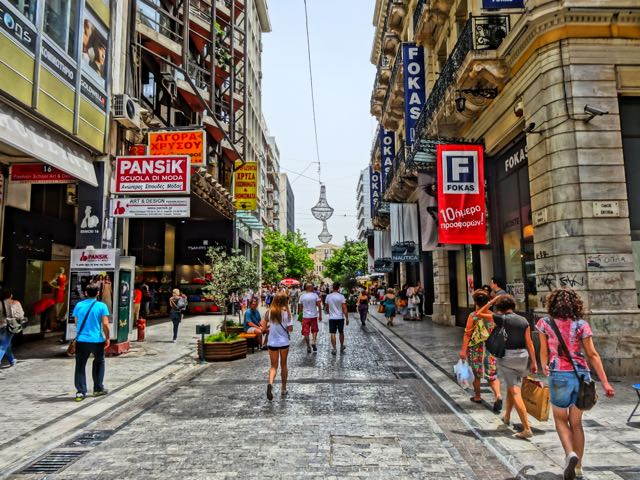

Image 2: 



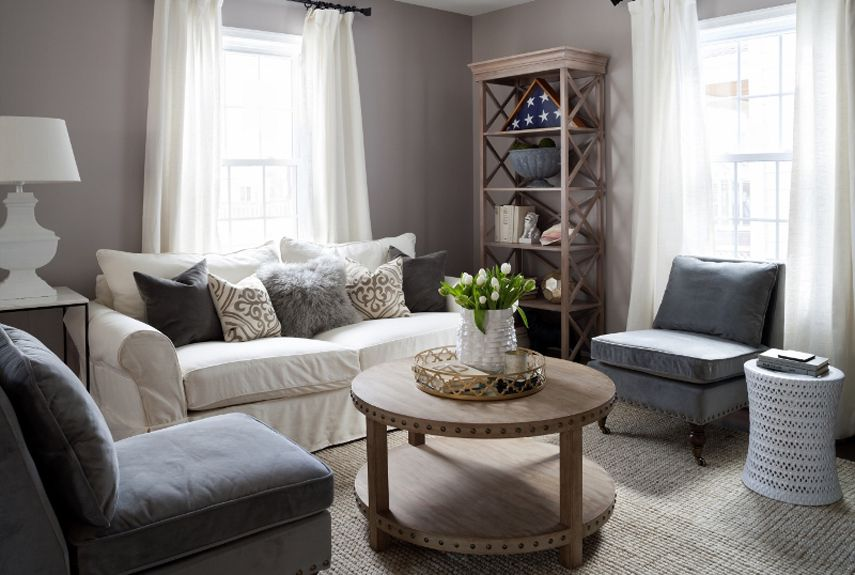

Image 3: 



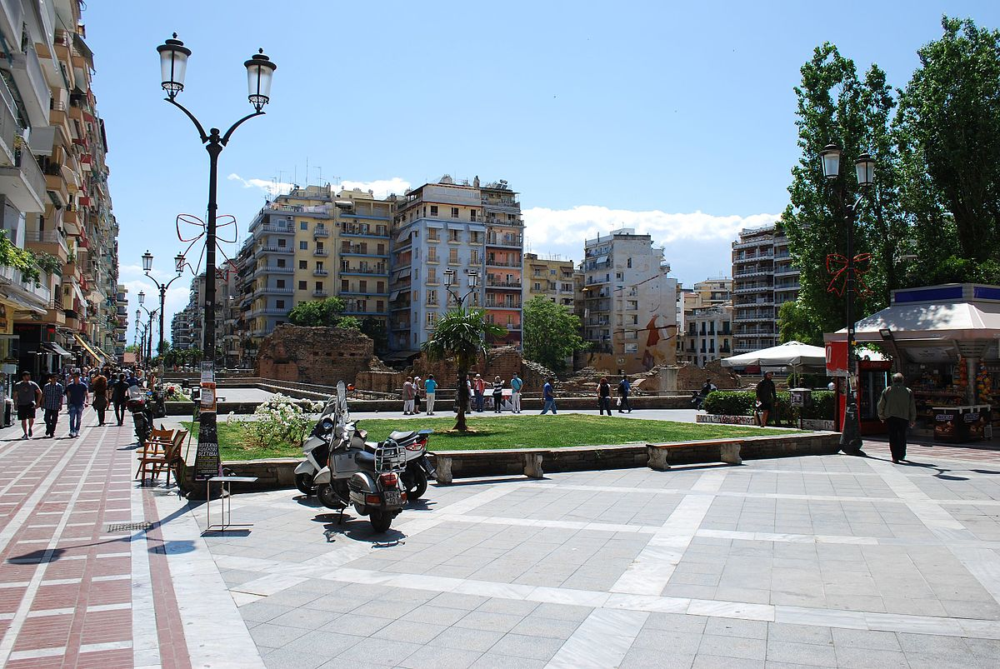

Image 4: 



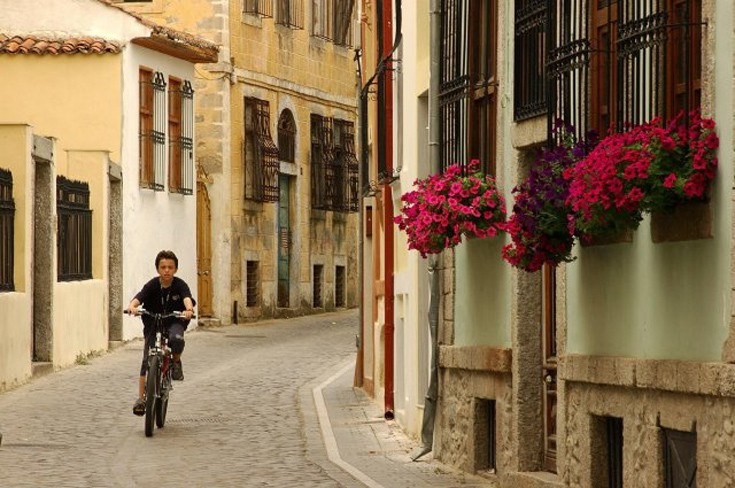

Image 5: 



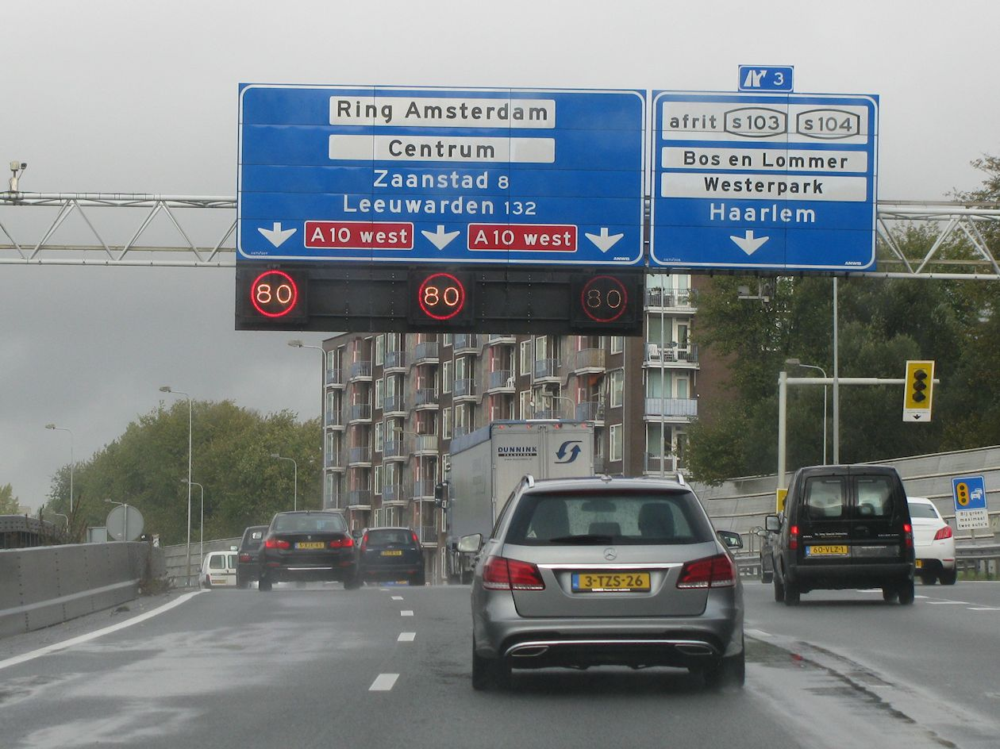

Image 6: 



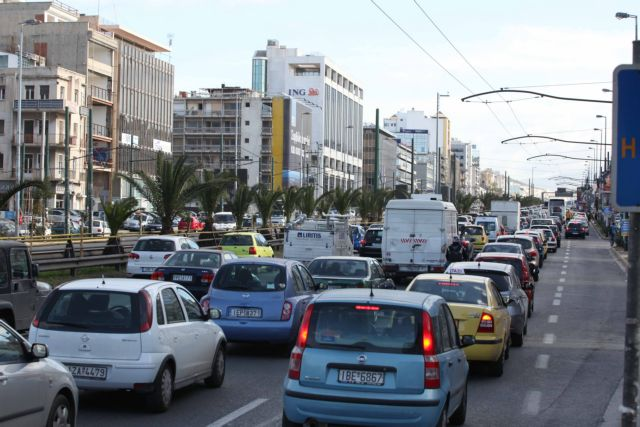

Image 7: 



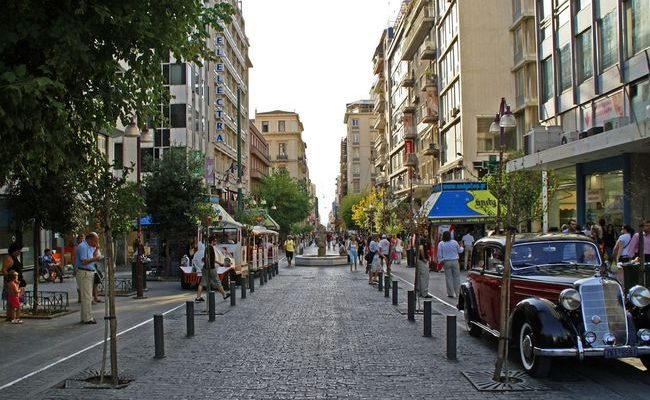

Image 8: 



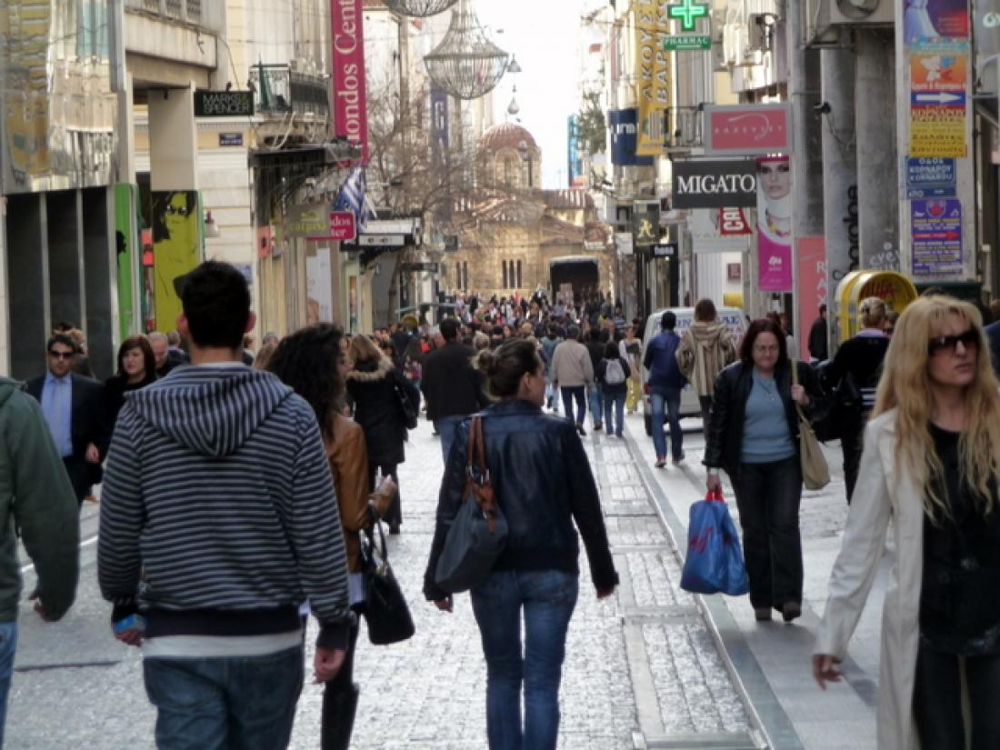

Image 9: 



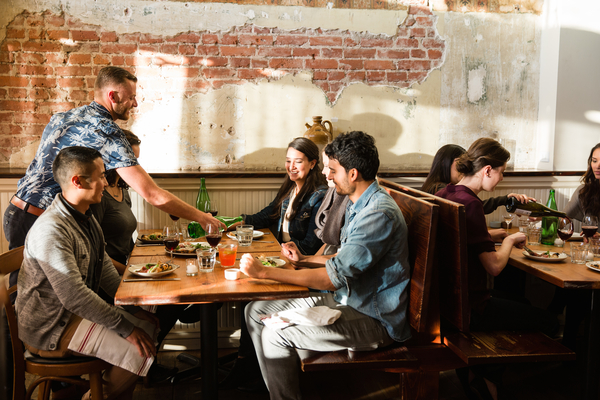

Image 10: 



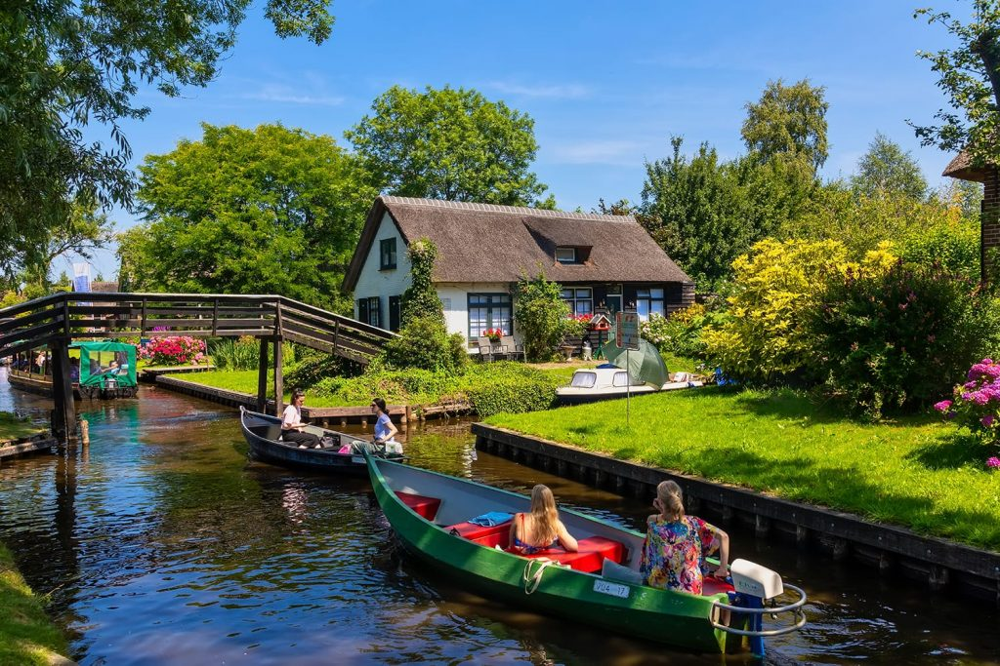

In [60]:
print("Image 1: \n")
cv2_imshow(im)
print("Image 2: \n")
cv2_imshow(im2)
print("Image 3: \n")
cv2_imshow(im3)
print("Image 4: \n")
cv2_imshow(im4)
print("Image 5: \n")
cv2_imshow(im5)
print("Image 6: \n")
cv2_imshow(im6)
print("Image 7: \n")
cv2_imshow(im7)
print("Image 8: \n")
cv2_imshow(im8)
print("Image 9: \n")
cv2_imshow(im9)
print("Image 10: \n")
cv2_imshow(im10)

# Run inference with instance segmentation model

In [0]:
cfg = get_cfg()
# add project-specific config (e.g., TensorMask) here if you're not running a model in detectron2's core library
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # set threshold for this model
# Find a model from detectron2's model zoo. You can either use the https://dl.fbaipublicfiles.... url, or use the detectron2:// shorthand
cfg.MODEL.WEIGHTS = "detectron2://COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl"
predictor = DefaultPredictor(cfg)
outputs = predictor(im)
outputs2 = predictor(im2)
outputs3 = predictor(im3)
outputs4 = predictor(im4)
outputs5 = predictor(im5)
outputs6 = predictor(im6)
outputs7 = predictor(im7)
outputs8 = predictor(im8)
outputs9 = predictor(im9)
outputs10 = predictor(im10)

In [62]:
# look at the outputs. See https://detectron2.readthedocs.io/tutorials/models.html#model-output-format for specification
outputs["instances"].pred_classes
outputs["instances"].pred_boxes

Boxes(tensor([[5.3616e+02, 2.8771e+02, 6.1547e+02, 4.7592e+02],
        [7.0557e+01, 2.8126e+02, 1.1253e+02, 3.9937e+02],
        [4.8492e+02, 2.9130e+02, 5.3965e+02, 4.4009e+02],
        [4.5919e+02, 2.8733e+02, 5.0218e+02, 4.1298e+02],
        [2.6126e+02, 2.9606e+02, 2.9418e+02, 4.0318e+02],
        [3.2413e+02, 2.8209e+02, 3.4966e+02, 3.5741e+02],
        [1.6786e+02, 2.8709e+02, 1.8785e+02, 3.4085e+02],
        [2.9692e+02, 2.7994e+02, 3.2160e+02, 3.5548e+02],
        [3.5612e+02, 2.8704e+02, 3.6996e+02, 3.2803e+02],
        [2.4298e+02, 2.9924e+02, 2.6507e+02, 3.5140e+02],
        [3.8034e+02, 2.8958e+02, 3.9666e+02, 3.2617e+02],
        [5.8751e-01, 2.8811e+02, 2.6468e+01, 3.7061e+02],
        [5.4628e+02, 3.1690e+02, 5.9638e+02, 4.0481e+02],
        [6.9171e+01, 2.9890e+02, 9.6975e+01, 3.5641e+02],
        [2.7997e+02, 2.7791e+02, 3.0006e+02, 2.8534e+02],
        [1.9791e+02, 3.3051e+02, 2.4906e+02, 3.6159e+02],
        [4.5345e+02, 3.5859e+02, 4.7333e+02, 3.8663e+02],
        

# Visualize instance segmentation results

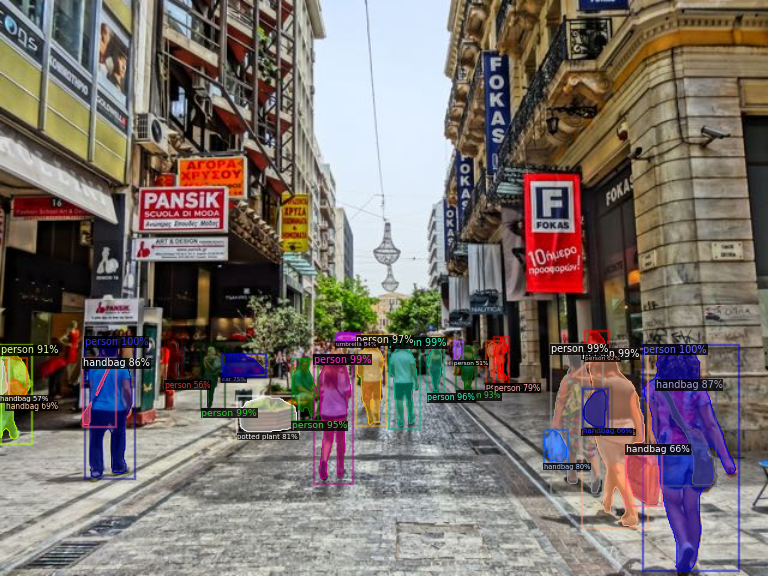

In [63]:
# We can use `Visualizer` to draw the predictions on the image.
v = Visualizer(im[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(v.get_image()[:, :, ::-1])

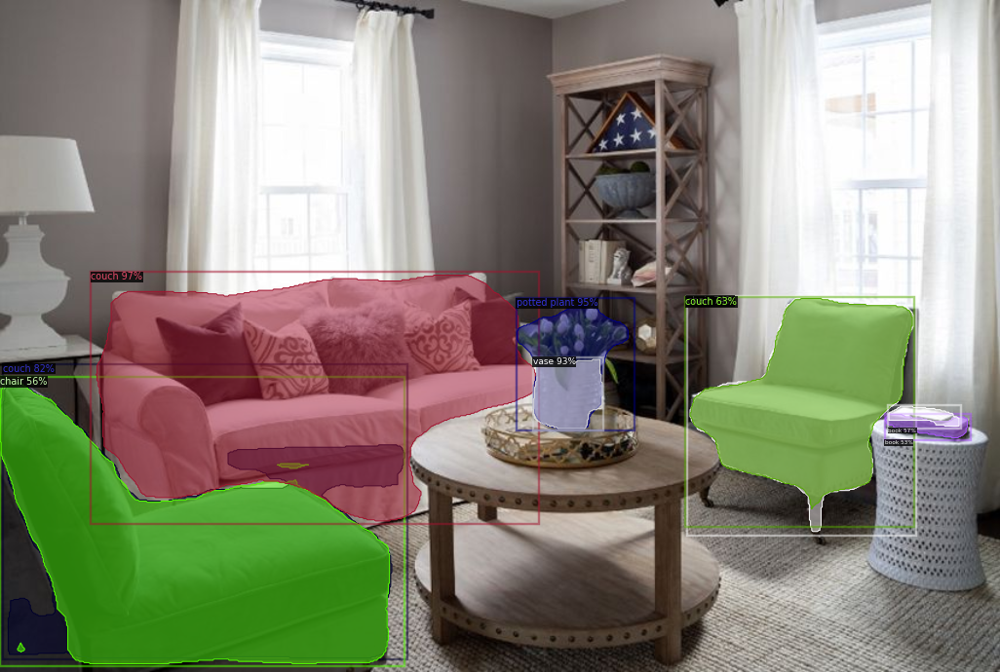

In [64]:
# We can use `Visualizer` to draw the predictions on the image.
v = Visualizer(im2[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
v = v.draw_instance_predictions(outputs2["instances"].to("cpu"))
cv2_imshow(v.get_image()[:, :, ::-1])

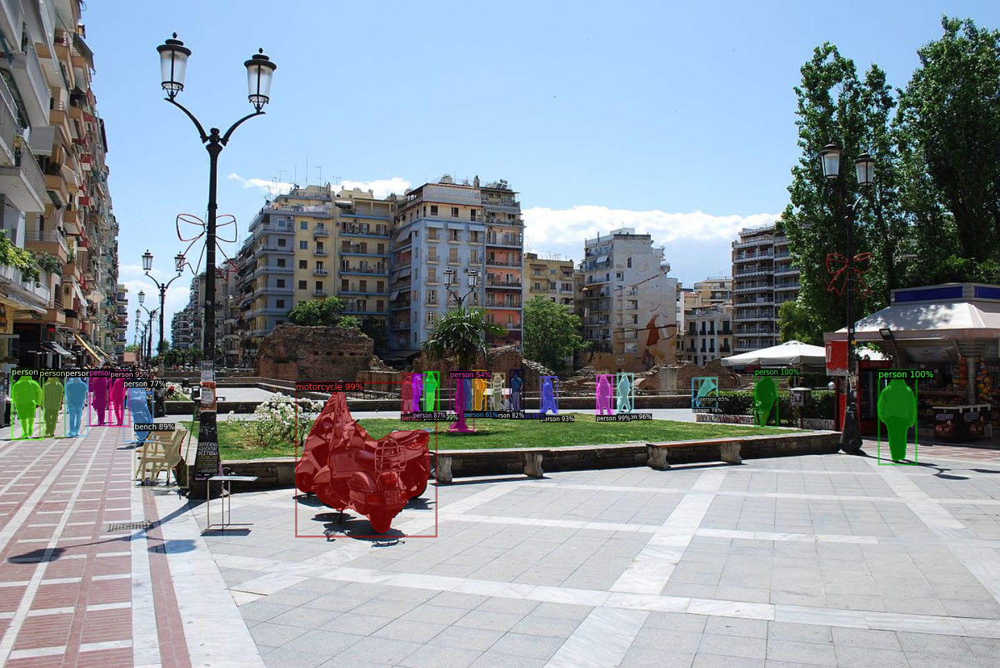

In [65]:
# We can use `Visualizer` to draw the predictions on the image.
v = Visualizer(im3[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
v = v.draw_instance_predictions(outputs3["instances"].to("cpu"))
cv2_imshow(v.get_image()[:, :, ::-1])

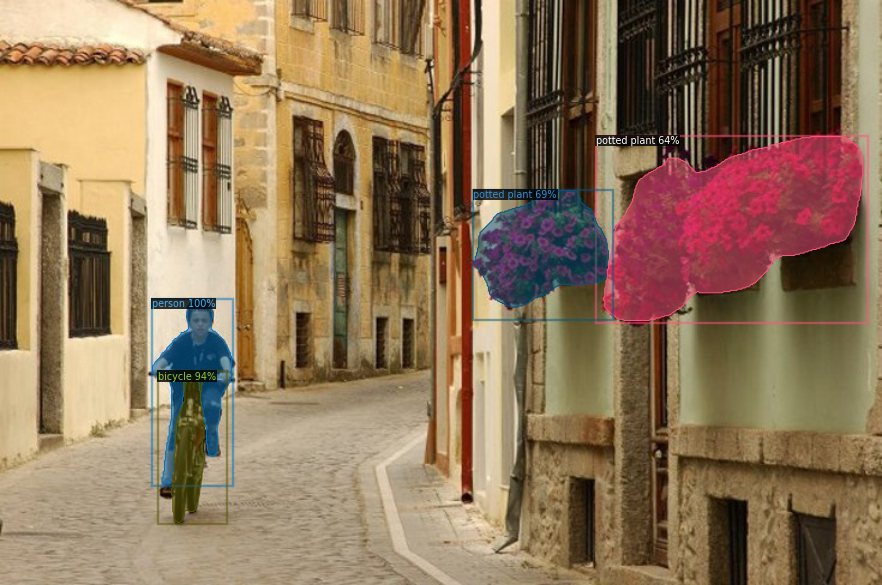

In [66]:
# We can use `Visualizer` to draw the predictions on the image.
v = Visualizer(im4[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
v = v.draw_instance_predictions(outputs4["instances"].to("cpu"))
cv2_imshow(v.get_image()[:, :, ::-1])

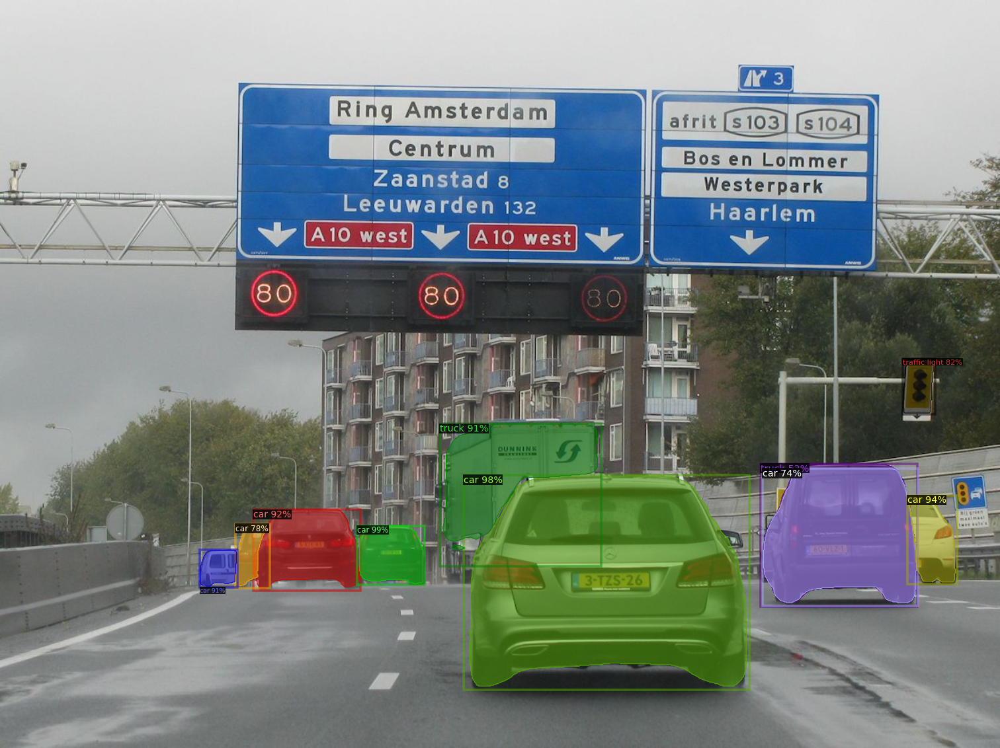

In [67]:
# We can use `Visualizer` to draw the predictions on the image.
v = Visualizer(im5[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
v = v.draw_instance_predictions(outputs5["instances"].to("cpu"))
cv2_imshow(v.get_image()[:, :, ::-1])

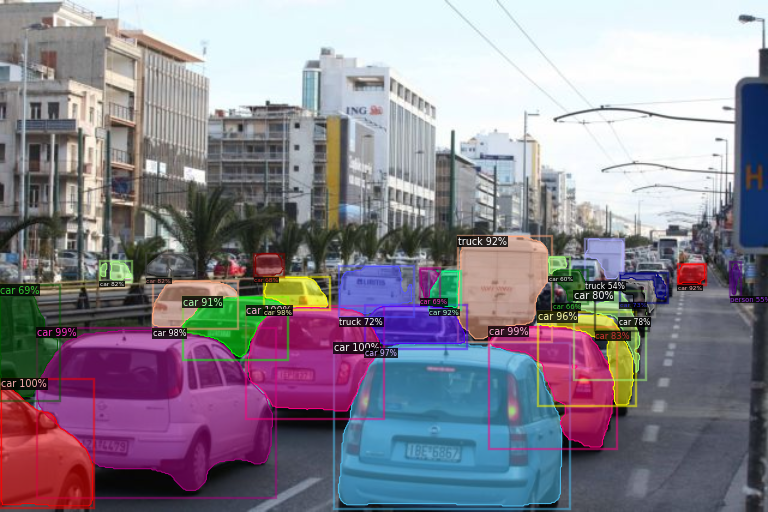

In [68]:
# We can use `Visualizer` to draw the predictions on the image.
v = Visualizer(im6[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
v = v.draw_instance_predictions(outputs6["instances"].to("cpu"))
cv2_imshow(v.get_image()[:, :, ::-1])

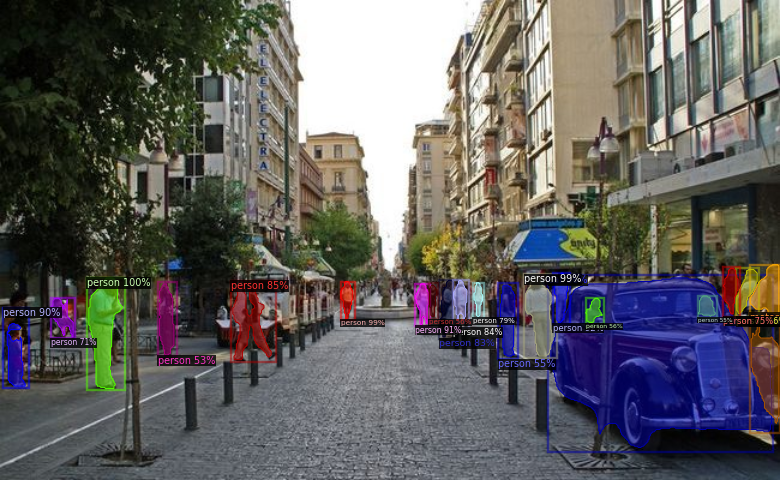

In [69]:
# We can use `Visualizer` to draw the predictions on the image.
v = Visualizer(im7[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
v = v.draw_instance_predictions(outputs7["instances"].to("cpu"))
cv2_imshow(v.get_image()[:, :, ::-1])

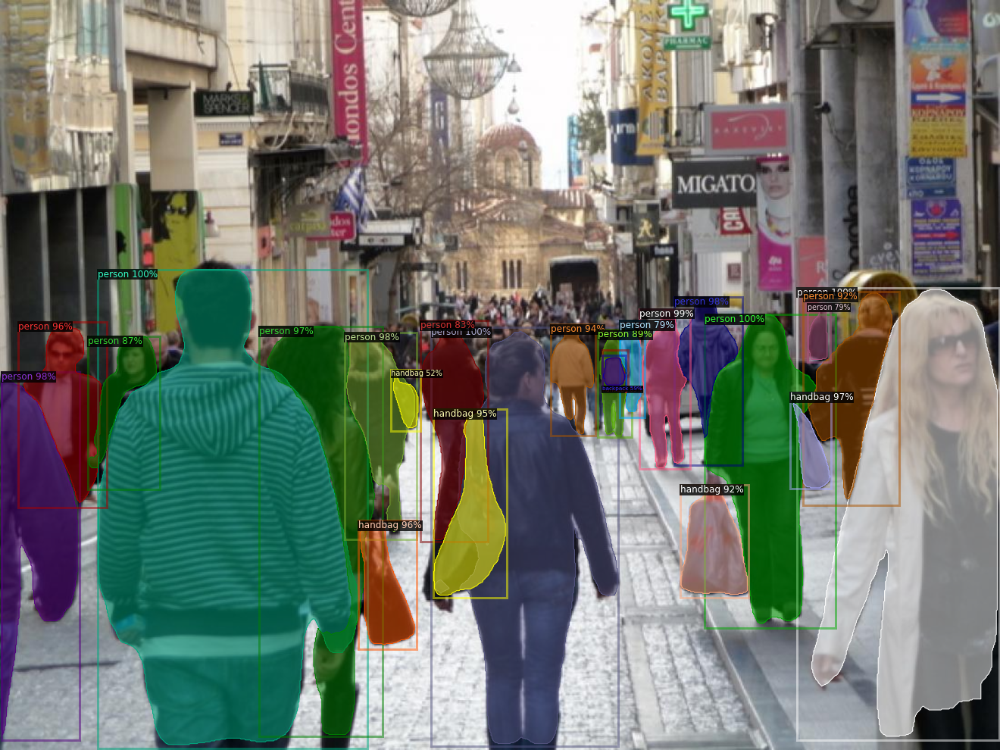

In [70]:
# We can use `Visualizer` to draw the predictions on the image.
v = Visualizer(im8[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
v = v.draw_instance_predictions(outputs8["instances"].to("cpu"))
cv2_imshow(v.get_image()[:, :, ::-1])

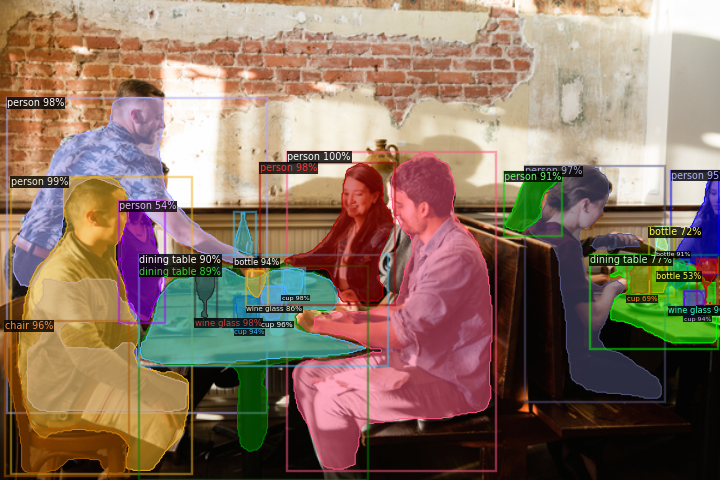

In [71]:
# We can use `Visualizer` to draw the predictions on the image.
v = Visualizer(im9[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
v = v.draw_instance_predictions(outputs9["instances"].to("cpu"))
cv2_imshow(v.get_image()[:, :, ::-1])

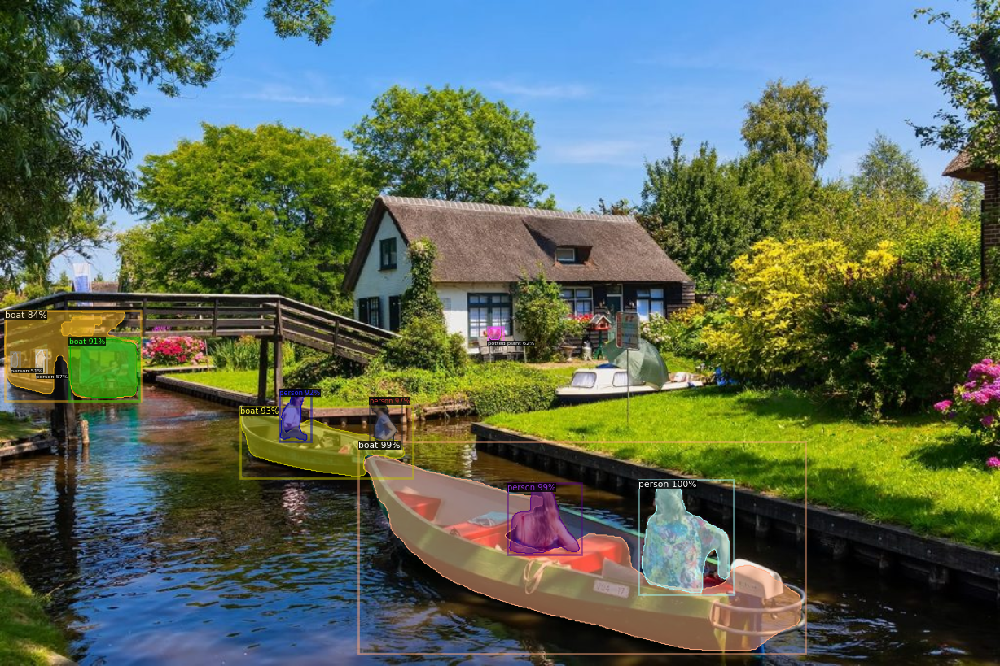

In [72]:
# We can use `Visualizer` to draw the predictions on the image.
v = Visualizer(im10[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
v = v.draw_instance_predictions(outputs10["instances"].to("cpu"))
cv2_imshow(v.get_image()[:, :, ::-1])

# Run panoptic segmentation on a video

In [0]:
!rm video-output.mkv

In [0]:
# Install dependencies, download the video, and crop 5 seconds for processing
!pip install youtube-dl
!pip uninstall -y opencv-python opencv-contrib-python
!apt install python3-opencv  # the one pre-installed have some issues
!youtube-dl https://www.youtube.com/watch?v=KBgfbxgD22U -f 22 -o video.mp4
!ffmpeg -i video.mp4 -t 00:02:56 -c:v copy video-clip.mp4

In [0]:
# Run frame-by-frame inference demo on this video (takes 3-4 minutes)
# Using a model trained on COCO dataset =>http://cocodataset.org/#home
!cd detectron2_repo && python demo/demo.py --config-file configs/COCO-PanopticSegmentation/panoptic_fpn_R_101_3x.yaml --video-input ../video-clip.mp4 --confidence-threshold 0.6 --output ../video-output.mkv \
  --opts MODEL.WEIGHTS detectron2://COCO-PanopticSegmentation/panoptic_fpn_R_101_3x/139514519/model_final_cafdb1.pkl

In [0]:
# Download the results
from google.colab import files
files.download('video-output.mkv')
#You can see the output video here => https://www.youtube.com/watch?v=kMTt5vgXQ4k&feature=youtu.be

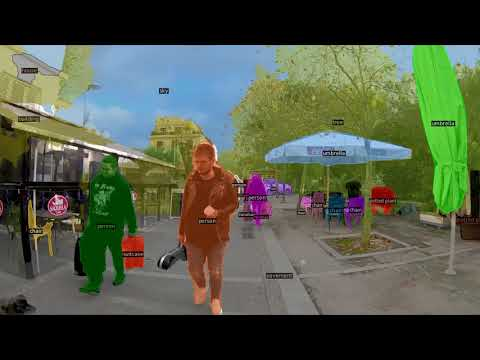

In [73]:
from IPython.display import YouTubeVideo
YouTubeVideo('kMTt5vgXQ4k')